# Final Workflow StatsLab

### Contents:
* [0. Overview](#overview)
    * [Our Objective](#objective)
    * [Gaussian Processes and Implementation](#gaussian-processes)
    * [Model Inputs and Outputs](#mod-in-out)
    * [Using This File to Identify Hotspots](#hotspots)
* [1. Helper Functions](#helpers)
* [2. Plots](#plots)
* [3. Workflow Illustration](#workflow)
    * [3.0 Preprocessing Data](#prepro)
    * [3.1 Fitting the Model from Scratch](#scratch)
    * [3.2 Plotting Previous Results](#plot-previous)
    * [3.3 Comparing Models in Different Time Brackets](#time-comparison)

## 0. Overview <a class="anchor" id="overview"></a>

### Objective: Determine Whether PM2.5 Hotspots are Genuine <a class="anchor" id="objective"></a>

Our main objective is to devise a method for assessing the confidence that an _identified_ hotspot is a _genuine_ hotspot, in the context of PM2.5 air pollution. We use data collected in Kigali, Rwanda, in September 2021. The team at Open Seneca fitted sensors to the bikes of twenty local delivery drivers, and gathered data about the ambient PM2.5 pollution they encountered over the course of the month. Keep in mind, though, that the _method_ we devise to identify genuine hotspots is more relevant than the genuine hotspots we identify in Kigali. We intend that the method be applicable to Open Seneca’s PM2.5 data from other cities.

The ‘hotspots’ are neighborhoods more polluted than some baseline level in the surrounding city. Just looking at the locations with the highest pollution measurements does not immediately reveal all hotspots. Pollution follows several temporal patterns, so one must adjust for the time at which measurements are made. Measurements are also geographically sparse; in a short time frame, the delivery drivers will only travel on so many roads. In order to make city-wide pollution comparisons, one must therefore leverage the available data to make predictions about the un-measured neighborhoods.

We propose adjusting for the temporal pattern by de-trending the data. Three baselines are computed: a 15-minute baseline, a daily baseline, and a baseline combining these two. A baseline is the rolling average of all measurements in the given time period. According to the number of active measurement devices and the dynamics of pollution in the city, an analyst can choose which of these baselines is most appropriate - and subtract it from the measurements to de-trend them.

Then we fit a Gaussian Process model, with PM2.5 pollution as the dependent variable and latitude & longitude as the independent variables. The idea is that we estimate a flexible regression surface across the whole city of Kigali for the mean pollution level in each spot. Equipped with a prior distribution, the Gaussian Process model allows for the construction of confidence intervals, and thus the assessment of how likely it is that any point in the city is a genuine hotspot. 

_Please consult the Gaussian Processes handout for technical details!_


### Using Gaussian Process Regression to Identify Air Pollution Hotspots <a class="anchor" id="gaussian-processes"></a>

To use gaussian process regression to identify airquality hotspots specifically, we have to overcome a few problems
- Number of observations (GP regression has complexity of $\mathcal{O}(n^3)$ so using all observations is not feasible) 
- Sparsity of extreme values (random subsampling to solve the complexity issue is not sufficient) 
- Kernel choice to encode a priori assumption on true surface of air pollution

In the following, we quickly address how we solve these three main problems and how they are implemented.
We employ an ensemble of gaussian processes regressions on subsamples of the data to reduce the run-time 
complexity. In the same step, we address the sparsity issue. 

The steps detailed in the following are all implemented in the `fitting_process()` function, which additionally pulls `calculate_pollution_levels()` and `stratified_sampling()`. Firstly, we divide the
data into 2-hourly time brackets to investigate the influence of time-of-day on the hotspots. We then
run the entire procedure for these brackets seperately. If one is not interested in the 
time-of-day variation, one can combine the results from the different time brackets in the end.
To address the sparsity issue, we do not employ random subsampling but stratified subsampling. 
To do so, we divide the city into tiles of size $250 m^2$ and compute the median pollution level per tile. 
Then, we subsample data by oversampling from low and high median pollution tiles. The percentiles (what is considered to be low or high pollution) can be chosen by `p_low`, `p_high`. The fractions of observations from low, medium and high median pollution levels in each subsample can be adjusted using `sample_frac_low`, `sample_frac_medium` and `sample_frac_high` (they need to sum to $1$). For each subsample, we then run a gaussian
process regression using the exponential kernel while optimizing the hyperparameters ($\sigma^2, \sigma_k^2, l$) via cross-validation.
We choose the exponential kernel as our a priori belief on the surface of pollution levels
is that is should be spikey and not overly smooth, which is encoded in the exponential
kernel, given by:
$$ k(x,y) = \sigma_k^2\exp\left(\frac{\lVert x-y\rVert_1}{l}\right).$$

If a smoother surface is desired, one can use the radial basis kernel, denoted `SquaredExponential` in GPFlow. Then, the models are evaluated on an equi-spaced grid over the city meaning we 
compute the predicted value and the variance of the predicted value for all the test points. Then, all the $B$ models within each bracket
are combined into one predicted value and respective variance per test point. This is done via:
$$\hat{f}_i = \frac{1}{B}\sum_{b=1}^B\hat{f}_{i,b}, i = 1,\dots,n\\
  \hat{\sigma}^2_i = \frac{1}{B}\sum_{b=1}^B\hat{\sigma}^2_{i,b} + \frac{1}{B}\sum_{b=1}^B(\hat{f}_{i,b}-\hat{f}_i)^2, i =1,\dots,n.
$$
The second term in the calculation of the variance captures the covariances between the different fitted models. If one is willing to assume independence (due to potentially non-overlapping subsamples of the data), one can specify this using `independence = True`, which negletcs the second term, thus decreasing the variance.

Knowing that all marginal distributions of this surface are normal random variables (gaussian), we can compute the z values by via:
$$z_i = \frac{\hat{f}_i - \operatorname{median}(pm_{2.5})}{\sqrt{\hat{\sigma}^2_i}}, i = 1,\dots,n. $$
We can then test for hotspots using the fact that $(z_i)_{i=1}^n$ are standard-normal random variables. Concretely, this means we test:
$$ H_0: z_i = \operatorname{median}(pm_{2.5})\ \textrm{vs.}\ H_1: z_i \geq \operatorname{median}(pm_{2.5}), i=1,\dots,n.$$
The null-hypothesis $H_0$ is rejected at level $\alpha$ if $z_i \geq \Phi^{-1}(1-\alpha)$, where $\Phi(\cdot)$ denotes the cdf of a standard normal random variable.

If one is not interested in the different time brackets, one can then average the predicitions and variances
for the different time brackets to get the overall hotspot measure, as is explained below.

### Model Inputs and Outputs <a class="anchor" id="mod-in-out"></a>

#### Model Inputs

Below we explain a handful of our parameter choices when we performed the modelling. To see all parameter definitions, consult [the definition](#helpers) of the `fitting_process()` function. To see the default parameters we used when calling the `fitting_process()` function, please refer to the workflow illustration in [section 3.1](#scratch). 
* `response` indicates the variable being modelled. We chose `pm25_detrended_15` corresponding to the 15-minute baseline. Other options are `pm25_detrended_day` corresponding to a daily baseline, and `pm25_detrended_comb` which averages these two baselines
* `iterations`: the number of fitted models; we chose 100. The higher the number of iterations, the more accurate the estimate, but the longer the computational time.
* `independence` a binary variable: `True` if one believes the bagged models are independent, `False` otherwise. We suggest using `False` for a more conservative estimate of the hotspot locations. Assuming independence will lead to lower variances and hence the identification of more hotspots. 
* `grid` corresponds to the size of the test dataset grid. A higher number provides a more granular prediction surface.


#### Model Outputs

`fitting_process()` outputs three dictionaries and a DataFrame, `df_res`. The first three dictionaries contain models, predicted values and variances for each two-hour time bracket (e.g., the "06:00:00" time bracket contains the outputs of a model run on all observations between "06:00:00" and "08:00:00", irrespective of the date). The DataFrame `df_res` contains predicted values and variances aggregated across all time brackets. Consult [the definition](#helpers) of `fitting_process()` for further explanation of the model outputs.

### How to Find Hotspots From the File <a class="anchor" id="hotspots"></a>

To identify hotspots from the data, we can use the `df_res` output from the `fitting_process()` function (the fourth output from the function). `df_res` is a data frame that contains latitude, longitude, predicted values, predicted variances and z-values for an equispaced grid of latitude/longitude test points over the city. A point that is significant at level $\alpha$ has a z-value higher than the 1-$\alpha$ quantile of the standard-normal distribution. For $\alpha = 0.05$, this corresponds to a z-value greater than 1.65. For $\alpha = 0.01$, this corresponds to a z-value greater than $2.33$. Filtering `df_res` for lat/lon pairs with z-values higher than this threshold will identify hotspots in the city. The greater the z-value, the more of a “hotpot” the point is. Note that we could also identify “low spots”, ie points with significantly low levels of pollution, by taking lat/lon pairs with very low z-values.

The functions `plot_zvalues_or_predictions()` and `plot_contours()` can be used for easy visualization of the hotspots. The function `plot_zvalues_or_predictions()` plots the z-values over a map of the city, with shades of red indicating higher z-values (hence more of a hotspot). `plot_contours` gives a contour map of the z-values but without being overlaid on a map of the city. `plot_contours()` also highlights in black outline areas that classify as hotspots at a particular confidence level by setting the “alpha” argument. Note that the functions can also be used to plot the predicted pollution levels by setting the “level” argument; however, plotting z-value makes more sense for hotspot identification.  

In [6]:
#!pip install gpflow
#!pip install folium
#!pip install pysal
#!pip install nbimporter

In [2]:
from typing import Sequence

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
plt.style.use('seaborn-v0_8-white')
from matplotlib.colors import ListedColormap

import time
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import pandas as pd
import statistics
import seaborn as sns
import tensorflow as tf
import pyproj
import gpflow

import os
import sys
import subprocess

from scipy.cluster.vq import kmeans

import folium
from folium.plugins import HeatMap
import branca.colormap as cm
from branca.colormap import linear
from branca.colormap import StepColormap

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.metrics import jaccard_score

import statsmodels.api as sm
import pickle

import scipy.stats as sps
import math
from tqdm import tqdm
tqdm.pandas()
# %matplotlib notebook

## 1. Helper Functions <a class="anchor" id="helpers"></a>

In [3]:
def data_cleanse(R_script_path, R_program_filepath, R_pkgs_filepath, alldata_filepath, data_cleaned_filepath):
    """
    A wrapper for running data_preprocess.R straight from this workbook. 
    Data_preprocess.R is an R script which preprocesses ('cleans') the raw data.
    Note: you do not need to run this function if you already have the cleaned data!

    INPUTS: 
    R_script_path: absolute filepath of data_preprocess.R (str)
    R_program_filepath: absolute filepath of the folder containing the latest R installation (str)
    R_libs_filepath: absolute filepath of the folder containing R packages (str)
    alldata_filepath: absolute filepath of alldata.csv (str)
    data_cleaned_filepath: absolute filepath to which data_cleaned.csv will be written (str)

    OUTPUTS:
    No return value. But produces a .csv file specified by data_cleaned_filepath for the 'cleaned' data.
    """
    sys.path.append(R_program_filepath)
    os.environ['R_LIBS'] = R_pkgs_filepath
    subprocess.run(['Rscript', R_script_path, alldata_filepath, data_cleaned_filepath])

In [51]:
def calculate_pollution_levels(tiles_df):
    
    """ This function computes the median pollution level per tile (250m^2) and adds it as a variable """

    tile_stats = tiles_df.groupby("tile_id")["pm25_detrended_15"].agg(["mean", "std"]).reset_index()
    tiles_df = tiles_df.merge(tile_stats, on = "tile_id")
    tiles_df["pollution_level"] = tiles_df["mean"]/ tiles_df["std"]
    return tiles_df

In [50]:
def stratified_sampling(df, p_low, p_high, sample_frac_low, sample_frac_medium,
                        sample_frac_high, add_covariates, response, size_subsample):
    
    """ 
        This function subsamples size_subsample number of observations while oversampling low and high pollution
        area, which are determined via p_low, p_high (percentiles of median pollution per tile). Sample_frac determine
        the composition of the size_subsample observations regarding low, medium and high pollution. Add covariates adds
        further covariates from osm and response chooses the response variable. Return X, Y for GP.
    """
    
    # Calculate the pollution levels for each tile
    df_poll = calculate_pollution_levels(df)
    df_poll = df_poll.dropna(subset=["pollution_level"])

    # Calculate the percentile pollution levels and split into groups
    p_low_value = np.percentile(df_poll["pollution_level"], p_low)
    p_high_value = np.percentile(df_poll["pollution_level"], p_high)

    low_pollution_tiles = df_poll[df_poll["pollution_level"] < p_low_value]
    medium_pollution_tiles = df_poll[(df_poll["pollution_level"] >= p_low_value) & (df_poll["pollution_level"] < p_high_value)]
    high_pollution_tiles = df_poll[df_poll["pollution_level"] > p_high_value]

    # Determine the sample size for each stratum
    total_sample_size = size_subsample * (sample_frac_low + sample_frac_medium + sample_frac_high)
    low_pollution_sample_size = int(total_sample_size * sample_frac_low)
    medium_pollution_sample_size = int(total_sample_size * sample_frac_medium)
    high_pollution_sample_size = int(total_sample_size * sample_frac_high)

    # Use stratified random sampling to select samples from each stratum
    low_pollution_sample = low_pollution_tiles.sample(n=low_pollution_sample_size, replace=False)
    medium_pollution_sample = medium_pollution_tiles.sample(n=medium_pollution_sample_size, replace=False)
    high_pollution_sample = high_pollution_tiles.sample(n=high_pollution_sample_size, replace=False)

    # Combine the samples from each stratum to obtain the final sample
    final_sample = pd.concat([low_pollution_sample, medium_pollution_sample, high_pollution_sample])
    
    # Get the X and Y arrays
    if add_covariates == False:
        X = final_sample[["x","y"]].to_numpy()
    else: 
        X= final_sample[["lat", "lon", "industrial", "major.road", "res.road"]].to_numpy()
    
    Y = final_sample[[response]].to_numpy()
    return X, Y

In [117]:
def fitting_process(response, iterations, p_low, p_high, sample_frac_low, sample_frac_medium, sample_frac_high,
                    add_covariates, size_subsample, grid, independence):
    
    """ 
        This function fits and evaluates the models on the test points.
        
        INPUTS:
        response:       detrended pm 2.5 (either "pm25_detrended_15" or "pm25_detrended_day")
        iterations:     number of iterations (total number of GP fitted)
        p_low:          lower cut-off in terms of percentile of median pollution level per tile for the stratified sampling (in [0,100])
        p_high:         higher cut-off in terms of percentile of median pollution level per tile for the stratified sampling (in [0,100])
        sample_frac_low, sample_frac_medium, sample_frac_high: 
                        perc. of obs from low, medium and high pollution levels (sum to 1)
        add_covariates: use street variables in estimation (True or False)
        size_subsample: number of observations per model
        grid:           sqrt(desired number of test observations)
        independence:   if one thinks that the models are independent (e.g. because of subsampling). This affects the variance
                        of the predictions (True or False)
                      
        OUTPUTS:
        (1) A dictionary that contains all the fitted models which can be accesses using the time bracket keys 
            (e.g. dict["06:00:00"])
        (2) A dictionary that contains all the predicted values on the test observations which ... " ------- "
        (3) A dictionary that contains all the predicted variances on the test observations which ... " ------- " 
        (4) A data frame that contains latitude, longitude, predicted values, predicted variances and z values 
            for the test points.
           
    """
    # Read in data
    df = pd.read_csv("df_gp.csv")

    # Define the detrended pm25 median
    median_pm25 = np.median(df[response])

    # Depending on the processing, you may need to adjust the datetime variable here so you just have the daytime.
    df["datetime"] = df["datetime"].str.rstrip("Z")
    df["datetime"] = pd.to_datetime(df["datetime"]).dt.time

    # Initialize empty dictionaries to save models
    models_dict = {}
    percentage_bracket = {}

    # Number of iterations
    num_iterations = iterations

    # Define the 2-hour brackets and the period of interest. If you want equal brackets through-out the entire day, use this. This
    # excludes the night-time due to not enough observations.
    # brackets = [
    #    pd.to_datetime("06:00:00").time(),
    #    pd.to_datetime("08:00:00").time(),
    #    pd.to_datetime("10:00:00").time(),
    #    pd.to_datetime("12:00:00").time(),
    #    pd.to_datetime("14:00:00").time(),
    #    pd.to_datetime("16:00:00").time(),
    #    pd.to_datetime("18:00:00").time()
    # ]
    
    # To run the results without time brackets (just one bracket). Take one random starting time and then adapt the 
    # code below to check if the obersvations is in range(bracket.hour, bracket.hour+23). Do not forget to change it back.
    brackets = [pd.to_datetime("00:00:00").time()]
    
    # Run the ensemble for all brackets seperately
    for bracket in brackets:
        print(f"Bracket: {bracket}")

        # Filter the data for the current bracket & compute percentage of observations in this bracket
        # df_bracket = df[df["datetime"].apply(lambda x: x.hour in range(bracket.hour, bracket.hour+1))]
        df_bracket = df[df["datetime"].apply(lambda x: x.hour in range(bracket.hour, bracket.hour+24))]
        percentage_bracket[str(bracket)] = len(df_bracket)/len(df)
        print(f"Percentage in Bracket: {100 * len(df_bracket)/len(df)}")
        
        # Initialize a list to save models for the current bracket
        models = []
        
        # Start the timer
        start_time = time.time()

        # Only run num_iteration / number of brackets per bracket as we take num_iterations to be the total number of fitted models
        for i in range(int(num_iterations/len(brackets))):
            print(f"Iteration {i+1}")

            # Sample data
            X, Y = stratified_sampling(df=df_bracket, p_low=p_low, p_high=p_high, sample_frac_low=sample_frac_low,
                                       sample_frac_medium=sample_frac_medium, sample_frac_high=sample_frac_high,
                                       add_covariates=add_covariates, response=response,
                                       size_subsample=size_subsample)

            # Initiate model and train it. The optimization sets l = 0, which creates algebraic issues so we set it to 0.1. 
            k = gpflow.kernels.Exponential()
            model = gpflow.models.GPR((X, Y), kernel=k)
            opt = gpflow.optimizers.Scipy()
            opt.minimize(model.training_loss, model.trainable_variables)
            # model.kernel.lengthscales.assign(0.1)  
            gpflow.utilities.print_summary(model, "notebook")

            # Save the model
            models.append(model)
            
            # Check if it's the first iteration and compute time taken for first iteration and extrapolate 
            if i == 0:
                elapsed_time = time.time() - start_time
                total_time = elapsed_time * num_iterations / 60

                # Print the predicted run-time
                print(f"Predicted total time for fitting the models: {total_time} minutes")

        # Save the model into the dict so we can access using bracket name
        models_dict[str(bracket)] = models
        
    # Now once we have ran all the models, we evaluate them to create the predictions on an equi-spaced grid of test points.
    # 20 meters apart
    min_x = 20 * math.floor(np.min(df["x"])/20)
    max_x = 20 * math.ceil(np.max(df["x"])/20)
    min_y = 20 * math.floor(np.min(df["y"])/20)
    max_y = 20 * math.ceil(np.max(df["y"])/20)

    # Create X_test
    x_s = np.arange(min_x, max_x, 20, dtype=float)
    y_s = np.arange(min_y, max_y, 20, dtype=float)
    x_grid, y_grid = np.meshgrid(x_s, y_s)
    X_test = np.column_stack((x_grid.ravel(), y_grid.ravel()))

    # Initialize empty dictionaries
    mean_values_dict = {}
    var_values_dict = {}

    # Loop through models_dict
    for bracket, models in models_dict.items():
        print(f"Evaluating models for bracket: {bracket}")

        # Initialize empty arrays
        mean_values = np.zeros((len(models), X_test.shape[0]))
        var_values = np.zeros((len(models), X_test.shape[0]))

        # Loop over each GP model and compute its predictions on the test points
        for i, model in enumerate(models):
            print(f"Iteration {i+1}")
            mean, var = model.predict_f(X_test)  
            mean = np.squeeze(mean.numpy())
            var = np.squeeze(var.numpy())
            mean_values[i, :] = mean
            var_values[i, :] = var

        # Compute the ensemble mean and variance by taking the average of the predicted values across all GP models
        ensemble_mean = np.mean(mean_values, axis=0)
        if independence == True:
            ensemble_var = np.mean(var_values, axis=0)
        else:
            ensemble_var = np.mean(var_values, axis=0) + np.mean((mean_values - ensemble_mean)**2, axis=0)

        # Save the mean and variance values in the respective dictionary
        mean_values_dict[str(bracket)] = ensemble_mean
        var_values_dict[str(bracket)] = ensemble_var
        
    # Initialize combined mean and variance arrays
    combined_mean = np.zeros(X_test.shape[0])
    combined_variance = np.zeros(X_test.shape[0])

    # Loop through the mean and variance dictionaries for each bracket
    total_weight = 0
    for bracket in brackets:

        # Get the respective mean and variance values
        mean_values_bracket = mean_values_dict[str(bracket)]
        var_values_bracket = var_values_dict[str(bracket)]

        # Accumulate the mean values
        combined_mean += mean_values_bracket*percentage_bracket[str(bracket)]

        # Accumulate the variances
        combined_variance += var_values_bracket*percentage_bracket[str(bracket)]
        
        # Accumulate the weights (if they do not sum to 1 as the brackets are not exhaustive, i.e. there are observations
        # that are not contained in any bracket)
        total_weight += percentage_bracket[str(bracket)]
        
    # Divide by the total weight to get the overall predicted values and predicted variances
    combined_mean /= total_weight
    combined_variance /= total_weight
    
    # Compute the z-values
    z_val = (combined_mean-median_pm25)/np.sqrt(combined_variance)

    # Construct csv to return
    df_res = pd.DataFrame({"x": X_test[:,0].tolist(), "y": X_test[:,1].tolist(),
                           "predicted_value": combined_mean, "predicted_variance": combined_variance,
                           "z_val": z_val})
        
    # Return the objects
    return models_dict, mean_values_dict, var_values_dict, df_res

In [15]:
def results_per_time_bracket(response, grid, bracket, dict_mean, dict_var):
    
    """ 
        This function produces the csv with the results as described in the introduction depending on the time frame
        
        INPUTS:
        response:       detrended pm 2.5 (either "pm25_detrended_15" or "pm25_detrended_day")
        grid:           sqrt(desired number of test observations)
        bracket:        time bracket one wants to investigate ("06:00:00", "08:00:00", ... , "18:00:00")
        dict_mean:      dictionary with predicted values from fitting_process
        dict_var:       dictionary with predicted variances from fitting_process
        
        OUTPUT: 
        (1) A data frame that contains latitude, longitude, predicted values, predicted variances and z values 
            for the test points (for this bracket)
    
    """

    # Conditional on time bracket
    df = pd.read_csv("data_cleaned_final.csv")

    # Define the detrended pm25 median
    median_pm25 = np.median(df[response])

    # Create X_test
    min_x = 20 * math.floor(np.min(df["x"])/20)
    max_x = 20 * math.ceil(np.max(df["x"])/20)
    min_y = 20 * math.floor(np.min(df["y"])/20)
    max_y = 20 * math.ceil(np.max(df["y"])/20)

    # Create X_test
    x_s = np.arange(min_x, max_x, 20, dtype=float)
    y_s = np.arange(min_y, max_y, 20, dtype=float)
    x_grid, y_grid = np.meshgrid(x_s, y_s)
    X_test = np.column_stack((x_grid.ravel(), y_grid.ravel()))

    # Compute the z-values
    z_val = (dict_mean[bracket]-median_pm25)/np.sqrt(dict_var[bracket])

    # Construct csv to return
    df_res = pd.DataFrame({"latitude": X_test[:,0].tolist(), "longitude": X_test[:,1].tolist(),
                           "predicted_value": dict_mean[bracket], "predicted_variance": dict_var[bracket],
                           "z_val": z_val})
    
    # Return
    return df_res

## 2. Plots <a class="anchor" id="plots"></a>

In [7]:
def plot_heatmap(df, level):
        
    """ 
        This function outputs a heatmap of predictions or z values over Kigali
        
        INPUTS:
        df: df_res data frame outputted from fitting_process function
        level: either "predicted_value" or "z_val", depending on what should be plotted (z value makes more sense
               in 99% of the cases)
               
        OUTPUT:
        Heatmap

    """

    # Set map location and zoom level
    min_lat = np.min(df["latitude"])
    max_lat = np.max(df["latitude"])
    min_lon = np.min(df["longitude"])
    max_lon = np.max(df["longitude"])
    
    # Center of plot
    mean_lat = 0.5*(min_lat+max_lat)
    mean_lon = 0.5*(min_lon+max_lon)
    m = folium.Map(location=[mean_lat, mean_lon], zoom_start=13)

    # Create heatmap layer
    heatmap = HeatMap(data=df[["latitude", "longitude", level]].values.tolist(),
                      radius=15)
    heatmap.add_to(m)

    # Create colorbar
    cmap = cm.LinearColormap(["blue", "green", "red"], vmin=df[level].min(), vmax=df[level].max())
    colorbar = cmap.to_step(10)
    colorbar.caption = "Z Values" if level == "z_val" else "Predictions"

    # Add the colorbar to the map
    for i in range(0, 10):
        colorbar.add_to(m)
    
    # Plot
    return m

In [7]:
def plot_zvalues_or_predictions(df, level = "z_val"):

    """ 
        This function outputs a plot of predictions or z values over a map of Kigali
        
        INPUTS:
        df: df_res data frame outputted from fitting_process function
        level: either "predicted_value" or "z_val", depending on what should be plotted (z value makes more sense
               in 99% of the cases)
               
        OUTPUT:
        Map
        
    """
    # Get coords in EPSG 4326
    coord_transform = pd.read_csv("coord_transform.csv")
    df = pd.merge(df, coord_transform[['x', 'y', 'lat', 'lon']], on=['x', 'y'], how='left')

    attr = 'Map data &copy; <a href="https://www.openstreetmap.org/copyright">OpenStreetMap</a> contributors'

    # Create map
    m = folium.Map(attr=attr)
    
    # Set bounds
    min_lat, min_lon = df['lat'].min(), df['lon'].min()
    max_lat, max_lon = df['lat'].max(), df['lon'].max()


    # Color scale for map 
    colorMap = cm.LinearColormap(['green', 'yellow', 'red'],
                                 vmin=df[level].min(), 
                                 vmax = df[level].max(), 
                                 caption = "Z Values" if level == "z_val" else "Predictions")

    for _, row in df.iterrows():
        folium.CircleMarker([row.lat, row.lon],
                            radius=2,
                            color = colorMap(row.z_val) if level == "z_val" else colorMap(row.predicted_value),
                            fill_color = colorMap(row.z_val) if level == "z_val" else colorMap(row.predicted_value),
                           ).add_to(m)

    # Add legend
    m.add_child(colorMap)

    # Fit bounds of the map
    m.fit_bounds([(min_lat, min_lon), (max_lat, max_lon)])

    # Display the map
    return m

In [30]:
def transform_coordinates(row, source_crs=pyproj.Proj(init='epsg:27700'), target_crs=pyproj.Proj(init='epsg:4326')):
    """
    Transform coordinates from one CRS to another.

    Inputs:
    row: row of dataframe with source coords
    source_crs: pyproj.Proj() object specifying source CRS
    target_crs: pyproj.Proj() object specifying target CRS

    Outputs:
    coords: coords in target CRS
    """
    lon, lat = pyproj.transform(source_crs, target_crs, row['x'], row['y'])
    return pd.Series({'lat': lat, 'lon': lon})

c:\Users\nial\anaconda3\envs\Statslab\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\nial\anaconda3\envs\Statslab\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [9]:
def plot_contours(df, level, sig_level):
    
    """ 
        This function outputs a contour map of predictions or z values over Kigali
        
        INPUTS:
        df: data frame from fitting_process function
        level: either "predicted_value" or "z_val", depending on what should be plotted (z value makes more sense
               in 99% of the cases)
        sig_level: significance level (alpha) in (0,1) (e.g. 0.01)
               
        OUTPUT:
        Contour plot

    """
    # Compute quantile of standard normal random variable
    quantile = sps.norm.ppf(1-sig_level)
    
    # Meshgrid
    x = df.longitude.unique()
    y = df.latitude.unique()

    # needs to be meshgrid format for contour plot to work
    X, Y = np.meshgrid(x, y)

    # looking up z-value from X and Y values
    def f(x, y):
        return df.loc[(df['longitude'] == x) & (df['latitude'] == y), 'z_val'].item()

    # need to define Z on meshgrid 
    vectorized_f = np.vectorize(f)
    Z = vectorized_f(X, Y)

    # Palette
    my_palette = ['#2C7BB6', '#00A6CA', '#00CCBC', '#90EB9D', '#FFFF8C', '#F9D057', '#F29E2E', '#E76818', '#D7191C']
    color_map = ListedColormap(my_palette)

    # Creating figure
    fig, ax = plt.subplots()

    # Adding contour plot
    contour = plt.contour(X, Y, Z, 20, cmap = color_map)
    contour_cutoff =  plt.contour(X, Y, Z>quantile,  colors = "black")

    ax.yaxis.grid(color="gray", linestyle="dashed", alpha = 0.3)
    ax.xaxis.grid(color="gray", linestyle="dashed", alpha = 0.3)

    # Color bar legend
    norm = matplotlib.colors.Normalize(vmin=contour.cvalues.min(), vmax=contour.cvalues.max())
    sm = plt.cm.ScalarMappable(norm=norm, cmap = contour.cmap)
    sm.set_array([])
    fig.colorbar(sm, ticks=contour.levels, ax = ax,
                 orientation = "horizontal", label = "Z value")

    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.show()

In [183]:
def plot_pm25_distribution(df):
    
    """ 
        This function plots the detrended pm2.5 level across the city (from the data, not modeled)
        This is a python rendering of create_pm25_map() found in create_detrended_pm25_map.R
        
        INPUTS:
        df: cleaned and processed data as outputted from data_preprocess.R 
               
        OUTPUT:
        PM2.5 plot

    """

    # Correct format
    summary_df = df.groupby('tile_id').agg(
      max_lon=('lon', 'max'),
      max_lat=('lat', 'max'),
      min_lon=('lon', 'min'),
      min_lat=('lat', 'min'),
      n_measurements=('lon', 'size'),
      med_pm25=('pm25_detrended_comb', 'median')   #median detrended PM25 concentration for each square
    ).reset_index()

    # Quantiles of median detrended PM2.5 concentration
    summary_df['quantile'] = pd.qcut(summary_df['med_pm25'], 10, labels=False)
    summary_df['lim'] = summary_df.groupby('quantile')['med_pm25'].transform('max').round()

    # Filter out NA values
    summary_df = summary_df[~summary_df['med_pm25'].isna()]

    # Get min, max, and quantile limits for PM2.5 for legend
    lim_values = summary_df.lim.unique().tolist()
    lim_values.sort()

    min_value = summary_df['lim'].min()
    max_value = summary_df['lim'].max()

    # Create map
    m = folium.Map()

    # Set bounds
    min_lat, min_lon = summary_df['min_lat'].min(), summary_df['min_lon'].min()
    max_lat, max_lon = summary_df['max_lat'].max(), summary_df['max_lon'].max()


    # Color scale for map - based on quantiles
    colorMap = cm.StepColormap(["#006837", "#1A9850", "#66BD63", "#A6D96A", "#D9EF8B", "#FFFFBF", "#FEE08B","#FDAE61", "#F46D43", "#D73027"], 
                             vmin=min_value, vmax=max_value, 
                              index=lim_values)

    # Color scale for legend - same as for map, but equispaced and labeled with quantiles
    # would love to label this with quantile limits, but looks like cm colormap does not support custom labels
    legend = cm.StepColormap([ "#006837", "#1A9850", "#66BD63", "#A6D96A",
                               "#D9EF8B", "#FFFFBF", "#FEE08B",
                              "#FDAE61", "#F46D43", "#D73027"], 
                        caption="Quantile of ΔPM2.5 from baseline: {}".format(lim_values),
                          tick_labels = [1,2, 3,4, 5,6, 7,8, 9, 10],
                               vmin=1, vmax=10)

    # Add rectangles to the map
    for _, row in summary_df.iterrows():
     rect = folium.Rectangle(
            bounds=[(row['min_lat'], row['min_lon']), (row['max_lat'], row['max_lon'])],
            fill=True,
            fill_opacity=1,
            color=None,
            fill_color = colorMap(row.lim)
        )
     rect.add_to(m)

    # Add legend
    m.add_child(legend)

    # Fit bounds of the map
    min_lat, min_lon = summary_df['min_lat'].min(), summary_df['min_lon'].min()
    max_lat, max_lon = summary_df['max_lat'].max(), summary_df['max_lon'].max()
    m.fit_bounds([(min_lat, min_lon), (max_lat, max_lon)])

    # Display the map
    return m

## 3. Workflow Illustration <a class="anchor" id="workflow"></a>
Quickly showing how to use the functions.

### 3.0 Preprocessing Data <a class="anchor" id="prepro"></a>

Run the below, changing all filepaths.
_Or_ open the data_preprocess.R file and run it directly in R.

In [ ]:
# Filepath to data_preprocess.R
R_script_path = r"C:\Users\nial\OneDrive\Documents\GitHub\Air-Quality-StatsLab\Code\data_preprocess.R"

# Filepath to latest installation of R
R_program_filepath = r"C:\Program Files\R\R-4.3.0\bin\x64"

# Filepath to R packages
R_pkgs_filepath = r"C:\Users\nial\OneDrive\Documents\R\win-library\4.1"

# Filepath to alldata.csv (raw data)
alldata_filepath = r"C:\Users\nial\OneDrive\Documents\ETH-Zürich-DESKTOP-9E8KBS8\AQ Data Collection\alldata.csv"

# Filepath where you want data_cleaned.csv
data_cleaned_filepath = r"C:\Users\nial\OneDrive\Documents\ETH-Zürich-DESKTOP-9E8KBS8\AQ Data Collection\data_cleaned.csv"

data_cleanse(R_script_path, R_program_filepath, R_pkgs_filepath, alldata_filepath, data_cleaned_filepath)

### 3.1 From Scratch <a class="anchor" id="scratch"></a>

In [123]:
# Path to data
path = r"C:\Users\nial\OneDrive\ETH Zürich\Statslab 2024\LAEI"
os.chdir(path)

# Fit and evaluate models
models_di, mean_values_di, var_values_di, df_final = fitting_process(response = "pm25_detrended_15", iterations = 100,
                                                                     p_low = 20, p_high = 80,
                                                                     sample_frac_low = 0.3, sample_frac_high = 0.3,
                                                                     sample_frac_medium = 0.4, add_covariates = False,
                                                                     size_subsample = 2000, grid = 200, independence = False)

# Save the objects
with open("models_dict_2hours.pkl", "wb") as f:
    pickle.dump(models_di, f)
    
with open("mean_dict_2hours.pkl", "wb") as f:
    pickle.dump(mean_values_di, f)
    
with open("var_dict_2hours.pkl", "wb") as f:
    pickle.dump(var_values_di, f)
    
df_final.to_csv("GP_results_London.csv", index = False)

Bracket: 00:00:00
Percentage in Bracket: 100.0
Iteration 1


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.45809
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,77.7263
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.6467


Predicted total time for fitting the models: 70.139954884847 minutes
Iteration 2


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.95619
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,74.6311
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.7302


Iteration 3


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.03676
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,89.2889
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.1646


Iteration 4


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.72674
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,94.7032
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,45.4749


Iteration 5


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.06262
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,241.369
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,51.9787


Iteration 6


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.86608
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,80.6423
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.6525


Iteration 7


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.1897
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,81.6178
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,50.9812


Iteration 8


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.976
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,67.5475
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,37.5411


Iteration 9


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,12.7461
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,39.7845
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,36.3669


Iteration 10


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,14.6542
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,56.11
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,35.5011


Iteration 11


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,15.8592
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,33.6633
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,34.9175


Iteration 12


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,12.3383
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,58.8755
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,45.0932


Iteration 13


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,13.8561
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,46.868
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.4587


Iteration 14


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.5836
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,96.6303
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,48.5986


Iteration 15


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.73963
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,168.342
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,50.5014


Iteration 16


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.94908
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,54.1108
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.0967


Iteration 17


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.90126
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,80.3041
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,39.6423


Iteration 18


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.1734
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,90.3472
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.6544


Iteration 19


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.24272
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,88.2663
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,45.6517


Iteration 20


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.0921
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,84.7632
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.9535


Iteration 21


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.5124
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,79.9705
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.5192


Iteration 22


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.7334
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,30.6795
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,26.9787


Iteration 23


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.44259
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,59.0333
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,36.2727


Iteration 24


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.77729
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,81.8829
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.8137


Iteration 25


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.5525
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,76.9217
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,47.5073


Iteration 26


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.91993
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,95.5488
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.7447


Iteration 27


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.6714
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,67.2892
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,46.125


Iteration 28


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.83935
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,77.9582
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,35.9892


Iteration 29


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.82751
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,70.1861
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.4177


Iteration 30


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.05979
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,60.1445
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,36.2159


Iteration 31


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.6219
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,64.8863
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.1662


Iteration 32


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.7736
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,44.6322
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,35.0491


Iteration 33


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.62688
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,152.069
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,49.0513


Iteration 34


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.82165
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,57.077
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.0504


Iteration 35


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.11446
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,101.254
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.1183


Iteration 36


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.30806
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,57.8368
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,36.0846


Iteration 37


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.49717
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,54.3278
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,35.7866


Iteration 38


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.8698
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,64.6066
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,45.3595


Iteration 39


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.6314
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,63.2556
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.7887


Iteration 40


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.65654
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,72.4719
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,41.5454


Iteration 41


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.8767
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,65.6379
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.9575


Iteration 42


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.87664
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,98.9036
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.2455


Iteration 43


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.77723
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,94.9094
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,53.8488


Iteration 44


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,14.9665
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,154.429
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,49.0208


Iteration 45


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.3627
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,49.8572
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.5087


Iteration 46


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.66032
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,61.9883
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,36.9727


Iteration 47


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.49136
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,79.6909
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.7609


Iteration 48


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.52796
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,74.0133
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,49.37


Iteration 49


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.48361
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,101.796
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.8218


Iteration 50


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.563
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,63.7742
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.2216


Iteration 51


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,6.76987
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,132.348
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,47.7068


Iteration 52


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.7712
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,62.1903
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,41.4496


Iteration 53


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.843
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,70.6891
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.5857


Iteration 54


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.8926
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,69.5997
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.652


Iteration 55


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,5.66912
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,266.583
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,46.3519


Iteration 56


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.6268
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,44.1769
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.4755


Iteration 57


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.2707
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,92.7836
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.1558


Iteration 58


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.5565
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,44.0228
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.3658


Iteration 59


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,14.6406
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,40.1021
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.0607


Iteration 60


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.09389
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,120.71
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.9899


Iteration 61


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.86157
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,70.4353
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,41.1547


Iteration 62


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.72176
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,81.9394
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.7419


Iteration 63


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.6634
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,64.8456
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,33.7644


Iteration 64


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.3756
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,82.1712
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,47.6386


Iteration 65


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.9813
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,72.6857
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,55.9517


Iteration 66


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,12.0102
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,62.294
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,48.87


Iteration 67


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.5617
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,66.3197
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.0523


Iteration 68


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.21305
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,65.2307
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.5516


Iteration 69


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.6693
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,52.5037
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.072


Iteration 70


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.72547
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,66.1497
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,45.538


Iteration 71


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.8536
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,77.3052
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.6952


Iteration 72


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.91835
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,74.137
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.8257


Iteration 73


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.7645
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,70.1797
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.7515


Iteration 74


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.68887
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,69.9515
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.8195


Iteration 75


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.55343
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,67.5204
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.0868


Iteration 76


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.971
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,51.8081
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.4758


Iteration 77


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,6.49746
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,162.48
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,51.2041


Iteration 78


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.45321
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,80.8802
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,32.441


Iteration 79


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.0521
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,114.49
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.3997


Iteration 80


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.83044
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,105.344
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,49.708


Iteration 81


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.69936
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,105.812
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.5487


Iteration 82


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.76055
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,87.7657
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.4828


Iteration 83


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.65282
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,92.8113
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,41.1381


Iteration 84


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.7206
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,81.3307
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.6818


Iteration 85


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.5246
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,50.5485
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,39.9848


Iteration 86


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.61523
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,79.1451
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,47.0112


Iteration 87


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.85005
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,97.5748
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,43.9458


Iteration 88


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.9614
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,62.8725
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,38.7801


Iteration 89


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.31017
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,63.1285
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,31.8806


Iteration 90


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,9.13624
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,62.91
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.9599


Iteration 91


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,22.0622
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,25.4473
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,29.8225


Iteration 92


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,14.3709
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,52.5943
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.8289


Iteration 93


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.9584
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,48.4294
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,42.2178


Iteration 94


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,10.8787
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,73.9432
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,40.1898


Iteration 95


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,11.9576
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,46.3995
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,39.9483


Iteration 96


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,7.12294
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,144.188
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,44.9479


Iteration 97


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,13.2964
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,47.4046
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,37.4221


Iteration 98


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,8.83496
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,101.61
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,45.4837


Iteration 99


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,14.4345
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,49.3232
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,46.9145


Iteration 100


name,class,transform,prior,trainable,shape,dtype,value
GPR.kernel.variance,Parameter,Softplus,,True,(),float64,12.8053
GPR.kernel.lengthscales,Parameter,Softplus,,True,(),float64,54.5887
GPR.likelihood.variance,Parameter,Softplus + Shift,,True,(),float64,37.1278


Evaluating models for bracket: 00:00:00
Iteration 1
Iteration 2
Iteration 3
Iteration 4
Iteration 5
Iteration 6
Iteration 7
Iteration 8
Iteration 9
Iteration 10
Iteration 11
Iteration 12
Iteration 13
Iteration 14
Iteration 15
Iteration 16
Iteration 17
Iteration 18
Iteration 19
Iteration 20
Iteration 21
Iteration 22
Iteration 23
Iteration 24
Iteration 25
Iteration 26
Iteration 27
Iteration 28
Iteration 29
Iteration 30
Iteration 31
Iteration 32
Iteration 33
Iteration 34
Iteration 35
Iteration 36
Iteration 37
Iteration 38
Iteration 39
Iteration 40
Iteration 41
Iteration 42
Iteration 43
Iteration 44
Iteration 45
Iteration 46
Iteration 47
Iteration 48
Iteration 49
Iteration 50
Iteration 51
Iteration 52
Iteration 53
Iteration 54
Iteration 55
Iteration 56
Iteration 57
Iteration 58
Iteration 59
Iteration 60
Iteration 61
Iteration 62
Iteration 63
Iteration 64
Iteration 65
Iteration 66
Iteration 67
Iteration 68
Iteration 69
Iteration 70
Iteration 71
Iteration 72
Iteration 73
Iteration 74
Iterati

### 3.2 Using the Previous Results <a class="anchor" id="plot-previous"></a>

In [4]:
# Path to data
path = r"C:\Users\nial\OneDrive\ETH Zürich\Statslab 2024\LAEI"
os.chdir(path)

# Read in the objects
with open("mean_dict_2hours.pkl", "rb") as file:
    mean_values_di = pickle.load(file)

with open("var_dict_2hours.pkl", "rb") as file:
    var_values_di = pickle.load(file)

with open("models_dict_2hours.pkl", "rb") as file:
    models_di = pickle.load(file)

df_final = pd.read_csv("gp_results_coord_transform.csv")
complete_simulation = pd.read_csv("complete_simulation.csv")

In [8]:
# Plot the z values
plot_zvalues_or_predictions(df_final, level = "z_val")

In [27]:
# Plot the contours
plot_contours(df = df_final, level = "z_val", sig_level = 0.05)

<IPython.core.display.Javascript object>

In [8]:
# Plot the actual detrended pm2.5 levels across the city - compare to hotspots defined by z-values
df_gp = pd.read_csv("df_gp.csv")
plot_pm25_distribution(df_gp)

### 3.3 Conditional on Time <a class="anchor" id="time-comparison"></a>
Does not seem to depend on time.

In [48]:
# Path to data
os.chdir("C:/Users/eminu/OneDrive/Desktop/Air-Quality-StatsLab/Data/Rawdata")
#os.chdir("/Users/sanelmaheinonen/Documents/ETH Sem 2/StatsLab/Air-Quality-Gaussian-Process/Data")

# Read in the objects
with open("dictionary_mean.pkl", "rb") as file:
    mean_values_di = pickle.load(file)

with open("dictionary_var.pkl", "rb") as file:
    var_values_di = pickle.load(file)
    
df_final = pd.read_csv("results.csv")

<IPython.core.display.Javascript object>


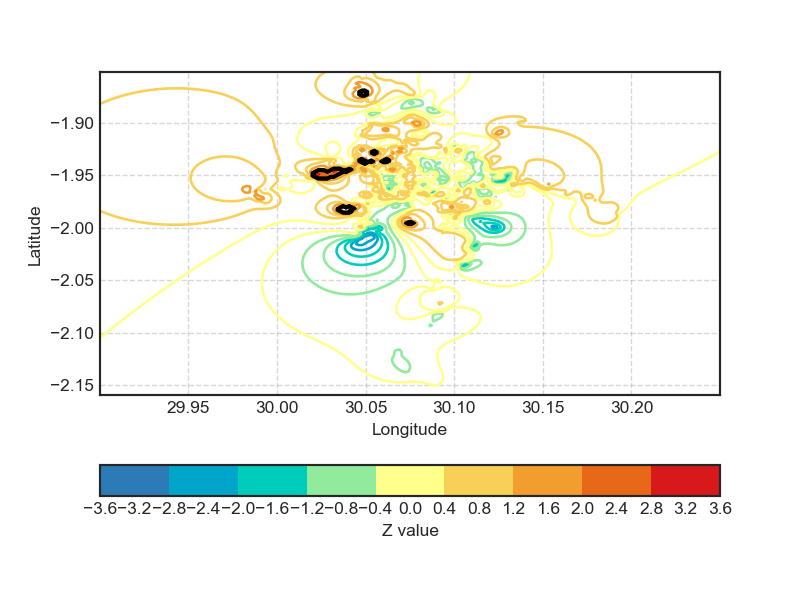

In [17]:
# Plot 06:00:00
plot_contours(df = results_per_time_bracket(response = "pm25_detrended_15", grid = 200, bracket = "06:00:00",
                                            dict_mean = mean_values_di, dict_var = var_values_di),
              level = "z_val", sig_level = 0.05)

### 4 Assessment of Predictions

In [29]:
def get_nearest_tile_ID(bbox, period, point, pm25_raster):
    """
    Retrieve ID of tile centroid nearest to an (x,y) point.
    
    Input:
    bbox: quaple (min_x, min_y, max_x, max_y)
    period: assuming equispaced grid; the # meters between two grid points
    point: (x,y) tuple
    pm25_raster: df containing tile IDs 

    Output:
    grid_centroid: grid point nearest (x,y)
    """
    # unpack tuples
    x,y = point
    min_x, min_y, max_x, max_y = bbox

    # find nearest grid point
    nearest_x, nearest_y = period * round(x/period), period * round(y/period)

    # constrain to bbox
    grid_x = max(min(nearest_x, max_x), min_x)
    grid_y = max(min(nearest_y, max_y), min_y)

    nearest_id = pm25_raster['tile_id'][(pm25_raster['x'] == grid_x) & (pm25_raster['y'] == grid_y)].iloc[0]

    return nearest_id

In [34]:
def combine_results(df_gp: pd.DataFrame, final_raster_pm25:pd.DataFrame, df_final:pd.DataFrame):
    """
    Combine results into a single dataframe with tile_id, PM2.5 and predicted Z value for all sampled tiles.

    Inputs:
    df_gp: dataframe including tile IDs where measurements taken
    final_raster_pm2.5: the true PM2.5 surface
    df_final: df of predicted values, variances and z values

    Outputs:
    df_combined: dataframe with PM2.5 percentiles & predicted Z values
    """
    # filter df_final to extent of true surface. TODO: investigate why df_final has a larger extent
    bbox = (529220.0, 181320.0, 532940.0, 183480.0) # London extent
    period = 20 # 20-meter grid squares
    min_x, min_y, max_x, max_y = bbox
    df_final = df_final.query('@min_x <= x <= @max_x and @min_y <= y <= @max_y')
    
    # compute tile_IDs
    df_final['tile_id'] = df_final.progress_apply(lambda row: get_nearest_tile_ID(bbox, period, (row['x'], row['y']), final_raster_pm25), axis=1)

    # filter raster to sampled tiles
    sampled_tiles = df_gp['tile_id'].unique()
    final_raster_pm25 = final_raster_pm25[final_raster_pm25['tile_id'].isin(sampled_tiles)]

    # merge with Z values
    df_combined = final_raster_pm25.merge(df_final[['tile_id','predicted_value','predicted_variance','z_val']], how='left', on='tile_id')

    # compute percentile of PM2.5
    df_combined['pm25_percentile'] =  df_combined['pm25'].progress_apply(lambda x: sps.percentileofscore(df_combined['pm25'], x))

    # get number of times tile sampled
    vc = df_gp['tile_id'].value_counts()
    df_combined = df_combined.merge(vc,how='left', left_on='tile_id', right_index=True).rename({'count':'tile_sample_count'}, axis=1)

    return df_combined

In [50]:
def get_hotspots_by_percentile(df_combined, alpha=0.95, n_percentiles=10):
    """
    Compute proportion of points classified as hotspots per PM2.5 percentile.

    Inputs:
    df_combined: output from combine_results()
    alpha: quantile of Gaussian distribution for hotspot classification
    n_percentiles: # percentiles (e.g., 5 = quintiles)

    Outputs:
    hotspots_by_decile: hotspot classification by percentile
    """
    # get critical value from N(0,1) CDF
    crit_val = sps.norm.ppf(alpha)

    # group by decile
    df_combined['pm25_decile'] = pd.qcut(df_combined['pm25_percentile'], n_percentiles, labels=False)
    hotspots_by_percentile = df_combined.groupby('pm25_decile')['z_val'].apply(lambda x: (x > crit_val).mean() * 100)

    df_combined.drop(['pm25_decile'], axis=1,inplace=True)

    return hotspots_by_percentile

In [138]:
def plot_PM25_hist(df_combined, n_bins=20, n_percentiles=20):
    """
    Plots a histogram of PM2.5 measurements in sampled tiles.

    Input:
    df_combined: output of combine_results()
    n_bins: # bins in histogram
    n_percentiles: # percentiles at which to draw vertical lines (e.g., 20 = quintiles)

    Output:
    plots histogram with PM2.5 deciles
    """
    percentiles = np.percentile(df_combined['pm25'], np.linspace(0,100,n_percentiles,endpoint=False))

    # Plot vertical lines at deciles
    for p in percentiles:
        plt.axvline(p, color='red', linestyle='--')
        
    plt.hist(df_combined['pm25'], bins=n_bins, color='blue', alpha=0.7)
    plt.title('PM2.5 Measurement by Tile')
    plt.xlabel('PM2.5 in tile')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()

I think this explains somewhat why the hotspot detection is so low. The distribution is very concentrated around the mode. Even the 90'th percentile is only a few points higher than the median.

In [49]:
def get_jaccard_scores(df_combined, quantiles=[0.5,0.75,0.9,0.95,0.99]):
    """
    Compute the Jaccard score for the tiles with highest PM2.5 value.

    Inputs:
    df_combined: output of combine_results()
    quantiles: consider PM2.5 values above this quantile (only >= 0.5 should be relevant)

    Outputs: 
    jaccard_scores: dict |A ∩ B|/|A U B|, where A = top PM2.5, B = top z scores
    """
    jaccard_scores = []

    for q in quantiles:

        # get top quantile
        q_pm25 = df_combined['pm25'].quantile(q)
        q_z_val = df_combined['z_val'].quantile(q)

        # binary series: is row in top quantile?
        pm25_binary = df_combined['pm25'] >= q_pm25
        predicted_value_binary = df_combined['predicted_value'] >= q_z_val

        # compute Jaccard index
        score = jaccard_score(pm25_binary, predicted_value_binary)
        jaccard_scores.append(score)

    return dict((q,round(s,3)) for q,s in zip(quantiles,jaccard_scores))

In [32]:
def save_results(folder, df_gp, final_raster_pm25, description, df_final, models_di, mean_values_di, var_values_di):
    """
    Save results about a modelling attempt, including data, plots and accuracy metrics.
    
    Inputs:
    folder: name of folder, to append to working directory
    df_gp: preprocessed data: the input to the Gaussian process fitting
    final_raster_pm25: the true PM2.5 surface over London
    description: string describing the results
    df_final: output from fitting_process()
    models_di: output from fitting_process()
    mean_values_di: output from fitting_process()
    var_values_di: output from fitting_process()
    """
    # create folder
    cd = os.getcwd()
    folder_path = os.path.join(cd, folder)
    
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)
        
    # save heatmap of predictions
    # map_obj = plot_zvalues_or_predictions(df_final, level = "z_val")
    # map_obj.save(folder + r'\map_output.html')

    # combine results
    df_combined = combine_results(df_gp, final_raster_pm25, df_final)

    # get accuracy scores
    hotspots_by_decile = get_hotspots_by_percentile(df_combined, n_percentiles=10)
    hotspots_by_vigintile = get_hotspots_by_percentile(df_combined, n_percentiles=20)
    hotspots_by_percentile = get_hotspots_by_percentile(df_combined, n_percentiles=100)
    jaccard_scores = get_jaccard_scores(df_combined)

    # save results
    with open(folder + r'\README.txt', 'w') as f:
        f.write(description)
    
    results_dict = {
        'df_combined': df_combined
        , 'hotspots_by_decile':hotspots_by_decile
        , 'hotspots_by_vigintile':hotspots_by_vigintile
        , 'hotspots_by_percentile':hotspots_by_percentile
        , 'jaccard_scores':jaccard_scores
        , 'models_di':models_di
        , 'mean_values_di':mean_values_di
        , 'var_values_di':var_values_di
    }

    with open(folder + r'\results.pkl', 'wb') as f:
        pickle.dump(results_dict, f)

    df_final.to_csv(folder + r'\df_final.csv',index=False)

#### Example: save results from a model run

In [10]:
# Path to data
path = r"C:\Users\nial\OneDrive\ETH Zürich\Statslab 2024\LAEI"
os.chdir(path)

# these do not change with model runs
df_gp = pd.read_csv("df_gp.csv")
final_raster_pm25 = pd.read_csv(r"Final_Raster_PM2.5.csv")

# outputs of fitting_process(); just loading here to test
df_final = pd.read_csv("df_final.csv")

with open("mean_dict_2hours.pkl", "rb") as file:
    mean_values_di = pickle.load(file)

with open("var_dict_2hours.pkl", "rb") as file:
    var_values_di = pickle.load(file)

with open("models_dict_2hours.pkl", "rb") as file:
    models_di = pickle.load(file)

# customise
folder = path + r"\results_attempt_1"

description = '''
Date: 01/04/2024

Description:
First attempt at fitting process. Gaussian Process method unchanged, except for removing the manual override of the lengthscale parameter at prediction time. 
Results look good in the plot, but accuracy metrics are low.

Call:
models_di, mean_values_di, var_values_di, df_final = fitting_process(response = "pm25_detrended_15", iterations = 100,
                                                                     p_low = 20, p_high = 80,
                                                                     sample_frac_low = 0.3, sample_frac_high = 0.3,
                                                                     sample_frac_medium = 0.4, add_covariates = False,
                                                                     size_subsample = 2000, grid = 200, independence = False)
'''

In [35]:
save_results(folder, df_gp, final_raster_pm25, description, df_final, models_di, mean_values_di, var_values_di)

100%|██████████| 20383/20383 [00:07<00:00, 2653.97it/s]
C:\Users\nial\AppData\Local\Temp\ipykernel_13036\2675523613.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['tile_id'] = df_final.progress_apply(lambda row: get_nearest_tile_ID(bbox, period, (row['x'], row['y']), final_raster_pm25), axis=1)
100%|██████████| 9859/9859 [00:00<00:00, 10609.61it/s]


In [37]:
with open(folder + r'\results.pkl', 'rb') as f:
    results_dict = pickle.load(f)

In [53]:
results_dict['jaccard_scores']

{0.5: 0.61, 0.75: 0.354, 0.9: 0.189, 0.95: 0.132, 0.99: 0.051}